In [1]:
!git clone https://github.com/DomMcOyle/TACO-expl
%cd /content/TACO-expl/
!git checkout add_detr
%cd /content/

Cloning into 'TACO-expl'...
remote: Enumerating objects: 2396, done.
remote: Counting objects: 100% (2396/2396), done.
remote: Compressing objects: 100% (1168/1168), done.
remote: Total 2396 (delta 1255), reused 2302 (delta 1189), pack-reused 0
Receiving objects: 100% (2396/2396), 131.87 MiB | 10.92 MiB/s, done.
Resolving deltas: 100% (1255/1255), done.
/content/TACO-expl
Branch 'add_detr' set up to track remote branch 'add_detr' from 'origin'.
Switched to a new branch 'add_detr'
/content


In [2]:
%cd /content/TACO-expl/HDDETR
!pip install -r requirements.txt
!pip install mmcv==2.1.0 -f https://download.openmmlab.com/mmcv/dist/cu118/torch2.1/index.html
!pip install mmdet
%cd /content/TACO-expl/HDDETR/models/ops
!python setup.py build install
# unit test (should see all checking is True)
#!python test.py
%cd /content/

/content/TACO-expl/HDDETR
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 51.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 63.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 28.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 289.6/289.6 kB 26.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 9.5 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-no

In [3]:
%cd /content/TACO-expl
!git pull origin add_detr

/content/TACO-expl
From https://github.com/DomMcOyle/TACO-expl
 * branch            add_detr   -> FETCH_HEAD
Already up to date.


In [4]:
!pip install grad-cam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 67.9 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for grad-cam: filename=grad_cam-1.5.2-py3-none-any.whl size=38335 sha256=bdb28c81f23fcfcbd2068ccb258f4dd919d5c9f04b6c9484bb0025022ffec0b7
  Stored in directory: /root/.cache/pip/wheels/b4/68/bb/d10381e86dc0de1c9354bce3d86bffcd247305058c40ce2e55
Successfully built grad-cam


In [1]:
%cd /content/TACO-expl
import os.path
import json
import argparse
import numpy as np
import random
import datetime as dt
import copy
import torch.nn as nn
from sklearn.model_selection import train_test_split
from pathlib import Path

from HDDETR.util.box_ops import generalized_box_iou
from PIL import Image
from pytorch_grad_cam.utils.image import show_cam_on_image
from pytorch_grad_cam import AblationCAM
from pytorch_grad_cam import EigenCAM
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam import GradCAMPlusPlus
from pytorch_grad_cam import ScoreCAM
from pytorch_grad_cam.ablation_layer import AblationLayer
from pytorch_grad_cam.ablation_layer import AblationLayerVit

import torch
import math
import torchvision
import matplotlib.pyplot as plt
import cv2
import torch.utils.data
from torch.utils.data import DataLoader
from pycocotools import mask as coco_mask

from HDDETR.datasets.torchvision_datasets.coco import CocoDetection as TvCocoDetection
import HDDETR.datasets.transforms as T
from HDDETR.datasets.data_prefetcher import data_prefetcher
from HDDETR.datasets.coco_eval import CocoEvaluator
from HDDETR.models.deformable_transformer import DeformableTransformerEncoderLayer, DeformableTransformerEncoder
from HDDETR.models.deformable_detr import MLP
from HDDETR.models.position_encoding import PositionEmbeddingSine
from torchvision.ops import RoIAlign
import HDDETR.util.misc as mutils
from HDDETR.util import box_ops

import HDDETR.models
from google.colab import drive
drive.mount("/content/MyDrive/")

/content/TACO-expl
Mounted at /content/MyDrive/


In [2]:
class MaskFrozenDETR(nn.Module):
  def __init__(self, detr, device, num_classes, box_channels=128):
    super().__init__()
    self.device = device
    self.detr = detr
    self.detr.num_queries = self.detr.num_queries_one2one
    self.detr.transformer.two_stage_num_proposals = self.detr.num_queries_one2one
    self.num_classes = num_classes
    for param in detr.parameters():
      param.requires_grad = False
    # vedi deformable encoder block
    pre_compression_channels = 256
    feature_enc_layer = DeformableTransformerEncoderLayer(d_model=pre_compression_channels,dropout=0, activation='gelu')
    box_enc_layer = DeformableTransformerEncoderLayer(d_model=box_channels,dropout=0, activation='gelu')
    self.feature_enc = DeformableTransformerEncoder(feature_enc_layer, 2)
    self.box_enc = DeformableTransformerEncoder(box_enc_layer, 2)
    self.box_pos_embedding = PositionEmbeddingSine(box_channels//2, normalize=True)
    self.channel_mapper = nn.Conv2d(pre_compression_channels, box_channels, kernel_size=1)
    self.neck = nn.Conv2d(96, pre_compression_channels, kernel_size=1)
    self.neck_gn = nn.GroupNorm(pre_compression_channels//32,pre_compression_channels)
    self.query_channel_mapper = nn.Linear(pre_compression_channels, box_channels)
    self.roialign = RoIAlign(output_size=(32,32),spatial_scale=0.25, sampling_ratio=-1)
    self.class_adapter = nn.Linear(pre_compression_channels, num_classes)
    self.topk = 128
    self.maskiouhead = MaskIOUHead(box_channels + 1)

  def forward(self, input):
    bs, _, h, w = input.tensors.shape
    # get output from the H-DETR
    detr_out = self.detr(input)

    # pass the multi-scale encoder maps to the two deformable layers
    enc_maps, _ = self.feature_enc(**detr_out["intermediate_enc_out"])

    # interpolate he maps to the backbone dimension
    # detr_out["backbone_out"].shape
    backbone_h, backbone_w = detr_out["backbone_out"].tensors.shape[-2], detr_out["backbone_out"].tensors.shape[-1]
    map_limit = detr_out["intermediate_enc_out"]["level_start_index"][1].item()
    enc_map_h = detr_out["intermediate_enc_out"]["spatial_shapes"][0,0].item()
    enc_map_w = detr_out["intermediate_enc_out"]["spatial_shapes"][0,1].item()
    enc_maps = enc_maps[:,:map_limit,:].reshape(bs, enc_map_h, enc_map_w, 256).permute(0,3,1,2)
    fe = mutils.interpolate(enc_maps, (backbone_h,backbone_w), mode="bilinear") # shape: (bs, ch, h, w)
    # TODO:linear interpolation?

    # sum the maps and reduce dimensionality
    c1 = self.neck_gn(self.neck(detr_out["backbone_out"].tensors)) # shape (bs,ch, h, w)
    f = c1 + fe

    # map channel reduction
    mapped_f = self.channel_mapper(f)

    # computing class for each proposal
    logits = detr_out['pred_logits']

    # computing top 100 proposals, boxes and queries
    ci = logits.sigmoid()
    topk_values, topk_indexes = torch.topk(
            ci.view(logits.shape[0], -1), self.topk, dim=1
    ) # takes top logits. may take a box more than once
    nboxes = detr_out["pred_boxes"]
    topk_boxes = topk_indexes // logits.shape[2]
    nboxes = torch.gather(nboxes, 1, topk_boxes.unsqueeze(-1).repeat(1, 1, 4))
    nboxes = nboxes[:,:self.topk, :]
    boxes = box_ops.box_cxcywh_to_xyxy(nboxes)
    img_h, img_w = input.sizes.unbind(1)
    scale_fct = torch.stack([img_w, img_h, img_w, img_h], dim=1)
    boxes = boxes * scale_fct[:, None, :]
    boxes = torch.clamp(boxes, min=0)
    object_queries = detr_out["decoder_out"][-1, :, :self.detr.num_queries_one2one, :]
    object_queries = torch.gather(object_queries, 1, topk_boxes.unsqueeze(-1).repeat(1,1,object_queries.shape[-1]))
    logits = torch.gather(logits, 1, topk_boxes.unsqueeze(-1).repeat(1,1, self.num_classes))


    batchindexes = torch.arange(bs).reshape(bs,1,1).repeat(1,self.topk,1).to(self.device)
    roiboxes = torch.cat([batchindexes, boxes], -1).reshape(bs*self.topk, 5)

    Ri = self.roialign(mapped_f, roiboxes).permute(0, 2, 3, 1).reshape(bs*self.topk, 32, 32, 128)
    maskRi = self.roialign(detr_out["backbone_out"].mask.to(torch.float32).unsqueeze(1), roiboxes)\
                 .to(torch.bool)\
                 .permute(0,2,3,1).squeeze().reshape(bs*self.topk, 32,32)

    box_pos = self.box_pos_embedding(mutils.NestedTensor(Ri, maskRi)).reshape(self.topk*bs, 32*32, 128)


    valid_ratios_box = torch.stack([self.detr.transformer.get_valid_ratio(m.unsqueeze(0)) for m in maskRi], 0)

    sp_shapes = torch.tensor([[32,32]]).to(self.device)
    level_start_index = torch.tensor([0]).to(self.device)
    Ri = Ri.reshape(bs*self.topk,32*32, 128)
    maskRi = maskRi.reshape(bs*self.topk,32*32)

    # TODO: position embedding?
    Ri, _ = self.box_enc(Ri,
                      padding_mask=maskRi,
                      spatial_shapes=sp_shapes,
                      pos=box_pos,
                      level_start_index=level_start_index,
                      valid_ratios=valid_ratios_box)


    object_queries = self.query_channel_mapper(object_queries).reshape(bs*self.topk, 128, 1)


    segmasks = torch.bmm(Ri, object_queries).reshape(bs*self.topk, 1, 32, 32)
    mask_scores = self.maskiouhead(torch.cat([segmasks.sigmoid(),
                                          Ri.reshape(bs*self.topk,32,32, 128).permute(0,3,1,2)], 1)).reshape(bs, self.topk)
    segmasks = segmasks.reshape(bs, self.topk, 32, 32)
    return {"pred_masks": segmasks,
            "pred_logits": logits,
            "pred_boxes": nboxes,
            "unnormal_boxes": boxes,
            "top_scores": topk_values,
            "mask_scores": mask_scores,
            "top_indexes": topk_indexes}

class MaskIOUHead(nn.Module):
  def __init__(self, input_ch=129):
    super().__init__()
    self.conv1 = nn.Conv2d(input_ch, 128, 3, 1, 1)
    self.conv2 = nn.Conv2d(128, 128, 3, 1, 1)
    self.conv3 = nn.Conv2d(128, 128, 3, 2, 1)
    self.conv4 = nn.Conv2d(128, 128, 3, 2, 1)
    self.mlp = MLP(128*8*8, 1024, 1, 3)
    self.relu = nn.ReLU()
  def forward(self, x):
    h = self.relu(self.conv1(x))
    h = self.relu(self.conv2(h))
    h = self.relu(self.conv3(h))
    h = self.relu(self.conv4(h))
    return self.mlp(h.flatten(1))

In [3]:
def load_detr(args, finetuning=False, load_dict="r50.pth"):
  model,crit, postproc = HDDETR.models.build(args)
  crit.num_classes = 10

  if finetuning:
      state_dict = torch.load(load_dict)["model"]
      to_del = []
      for k in state_dict.keys():
        if "class_embed" in k:
          to_del.append(k)
      for k in to_del:
        del state_dict[k]
  else:
      state_dict = torch.load(load_dict)["model_state_dict"]
      model.num_queries = 300
      model.transformer.two_stage_num_proposals = 300
      postproc.update({"segm": HDDETR.models.segmentation.PostProcessSegmMFD()})
      postproc.update({"bbox": HDDETR.models.deformable_detr.PostProcessMFD()})
      crit.losses.append("masksMFD")
      crit.losses.remove("boxes")
      crit.losses.remove("labels")
      crit.weight_dict["loss_mask"] = 1
      crit.weight_dict["loss_dice"] = 1
  print("***LOADING DICT***")
  model.load_state_dict(state_dict, strict=False)
  return model, crit, postproc

In [4]:
def load_mfdetr(mfdetr_path, detr_path, args, num_classes, device):
  detr, criterion, postprocessor = load_detr(args, load_dict=detr_path)
  mfdetr = MaskFrozenDETR(detr, device, num_classes)
  load_checkpoint = torch.load(mfdetr_path)
  mfdetr.load_state_dict(load_checkpoint["model_state_dict"])

  return mfdetr, postprocessor

In [5]:
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self
args = AttrDict()
args.output_dir = './out/'
args.with_box_refine = True
args.two_stage = True
args.dim_feedforward = 2048
args.num_queries_one2one = 300
args.num_queries_one2many = 1500
args.k_one2many = 6
args.lambda_one2many = 1.0
args.mixed_selection = True
args.look_forward_twice = True
args.dataset_file = "coco"
args.device = 'cuda'
args.hidden_dim = 256
args.position_embedding = 'sine'
args.position_embedding_scale = np.pi *2
args.lr_backbone =1e-5
args.backbone = "swin_tiny"
args.pretrained_backbone_path = None
args.masks = False
args.num_feature_levels = 4
args.dilation = False
args.nheads = 8
args.enc_layers = 6
args.dec_layers = 6
args.dim_feedforwards = 2048
args.dropout = 0
args.dec_n_points = 4
args.enc_n_points = 4
args.use_checkpoint = True
args.aux_loss = True
args.cls_loss_coef=2
args.giou_loss_coef=2
args.focal_alpha=0.25
args.topk=100
args.bbox_loss_coef=5 #5
args.set_cost_class=2
args.set_cost_bbox=5
args.set_cost_giou=2
args.num_classes = 10
args.drop_path_rate = 0.2
args.aux_loss = False

In [6]:
device = torch.device("cuda")
# mfdetr_path = "/content/MyDrive/MyDrive/MFDETRwithlessloss+maskscore+neckfinalcheckpoint_4.pth"
# detr_path = "/content/MyDrive/MyDrive/ML4CVFTSWINHybOfffinalcheckpoint_5.pth"

mfdetr_path = "/content/MyDrive/MyDrive/checkpointML4CV/MFDETRllmsn2layer4finalcheckpoint_6.pth"
detr_path = "/content/MyDrive/MyDrive/checkpointML4CV/ML4CVFTSWINOffCos12efinalcheckpoint_9.pth"

num_classes = 10

In [7]:
transform = torchvision.transforms.Compose([
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Resize(800),
    torchvision.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [8]:
img = Image.open("/content/MyDrive/MyDrive/TACO/000038.jpg")
input_tensor = transform(img)
input_tensor = input_tensor.unsqueeze(0)

In [9]:
img_resized = torchvision.transforms.Resize(800)(img)

In [ ]:
input_tensor.requires_grad_();

In [10]:
input_tensor = input_tensor.to(device)
batch_input = mutils.collate_fn([input_tensor])

In [11]:
mfdetr, postpos = load_mfdetr(mfdetr_path, detr_path, args, num_classes, device)
mfdetr.eval()
mfdetr = mfdetr.to(device)

/usr/local/lib/python3.10/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


topk for eval: 100
***LOADING DICT***


In [39]:
output = mfdetr(batch_input[0])

/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:464: UserWarning: torch.utils.checkpoint: the use_reentrant parameter should be passed explicitly. In version 2.4 we will raise an exception if use_reentrant is not passed. use_reentrant=False is recommended, but if you need to preserve the current default behavior, you can pass use_reentrant=True. Refer to docs for more details on the differences between the two variants.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:91: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn(


In [67]:
# postpos["bbox"].threshold = 0.8
postpos["segm"].threshold = 0.5

In [68]:
orig_target_sizes = torch.tensor([[img_resized.size[1], img_resized.size[0]]]).to("cuda")
results = postpos["bbox"](output, orig_target_sizes)
results = postpos["segm"](results, output, orig_target_sizes, orig_target_sizes)

In [52]:
import cv2
import numpy as np
from random import randrange

class_names = ["Bottle", "Bottle cap", "Can", "Cigarette", "Cup", "Lid", "Plastic bag & wrapper", "Pop tab", "Straw"]

def draw_mask(image, mask_generated, label, box):
  label = label - 1

  np_img = np.asarray(image)
  color_cv = list(np.random.random(size=3) * 256)
  color = np.array([color_cv[0], color_cv[1], color_cv[2]])

  masked_image = np.where(mask_generated.astype(int), color, np_img)
  masked_image = masked_image.astype(np.uint8)
  img_with_mask = cv2.addWeighted(np_img, 0.3, masked_image, 0.7, 0)

  start_point = (int(box[0]), int(box[1]))
  end_point = (int(box[2]), int(box[3]))

  # img_with_mask = cv2.rectangle(img_with_mask, start_point, end_point, color_cv, 2)
  # img_with_mask = cv2.putText(img_with_mask, class_names[label], (int(box[0]), int(box[1]) - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 0), 1)
  return img_with_mask

In [42]:
def filter_results(results, th_iou=0.001, th_score=0.1):
  res = {"boxes": results[0]["boxes"][0].unsqueeze(0), "labels": results[0]["labels"][0].unsqueeze(0), "masks": results[0]["masks"][0], "scores": results[0]["scores"][0].unsqueeze(0)}

  for (box, label, mask, score) in zip(results[0]["boxes"][1:], results[0]["labels"][1:], results[0]["masks"][1:], results[0]["scores"][1:]):
    scores = generalized_box_iou(box.unsqueeze(0), res["boxes"][res["labels"] == label])

    # if not any([((box == _box).all() and label == _label) for _box, _label in zip(res["boxes"], res["labels"])]):
    if not ((scores > th_iou).any()) and not any([(box == _box).all() for _box in res["boxes"]]) and score > th_score:
      res["boxes"] = torch.vstack((res["boxes"], box))
      res["labels"] = torch.hstack((res["labels"], label))
      res["masks"] = torch.vstack((res["masks"], mask))
      res["scores"] = torch.hstack((res["scores"], score))

  return res

In [43]:
def sort_results_by_score(results):
  _, sorted_indices = torch.sort(results[0]["scores"], descending=True)

  for k, v in results[0].items():
    results[0][k] = torch.stack([v[i] for i in sorted_indices], dim=0)

  return results

In [69]:
sorted_res = sort_results_by_score(results)

In [70]:
filtered_res = filter_results(sorted_res, 0.001, 0.05)

In [71]:
img_with_mask = img_resized

for (mask, label, box) in zip(filtered_res["masks"], filtered_res["labels"], filtered_res["boxes"]):
  mask = mask.unsqueeze(0)
  mask = mask.cpu().numpy()[0]
  mask = np.stack([mask, mask, mask], axis=-1)
  img_with_mask = draw_mask(img_with_mask, mask, label, box)

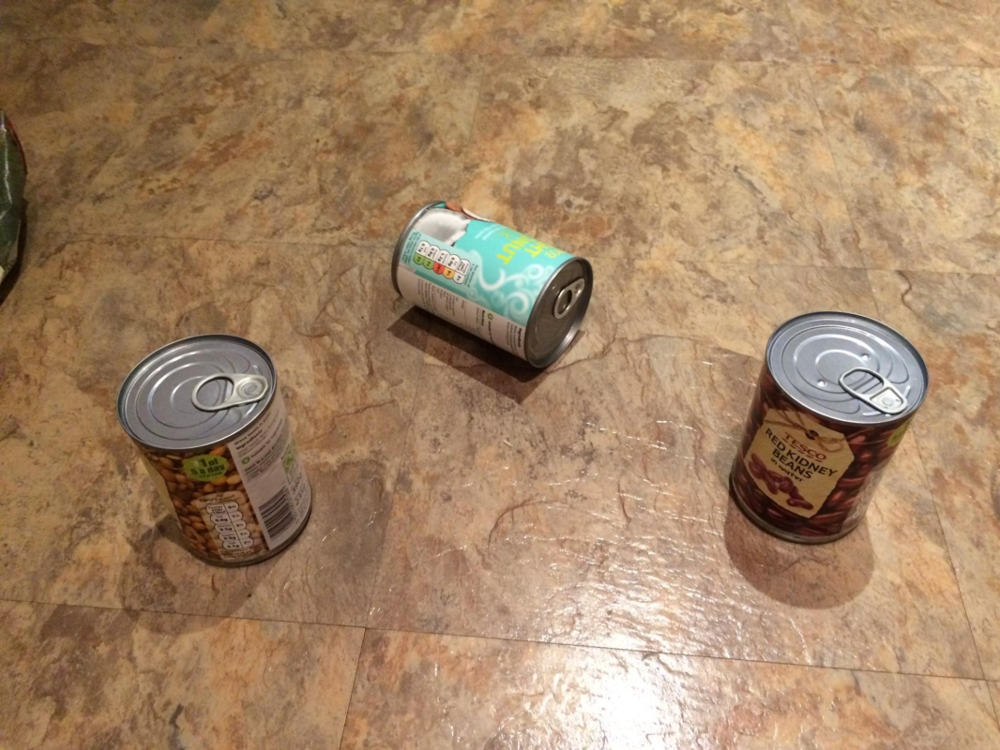

In [ ]:
img_resized

0.7

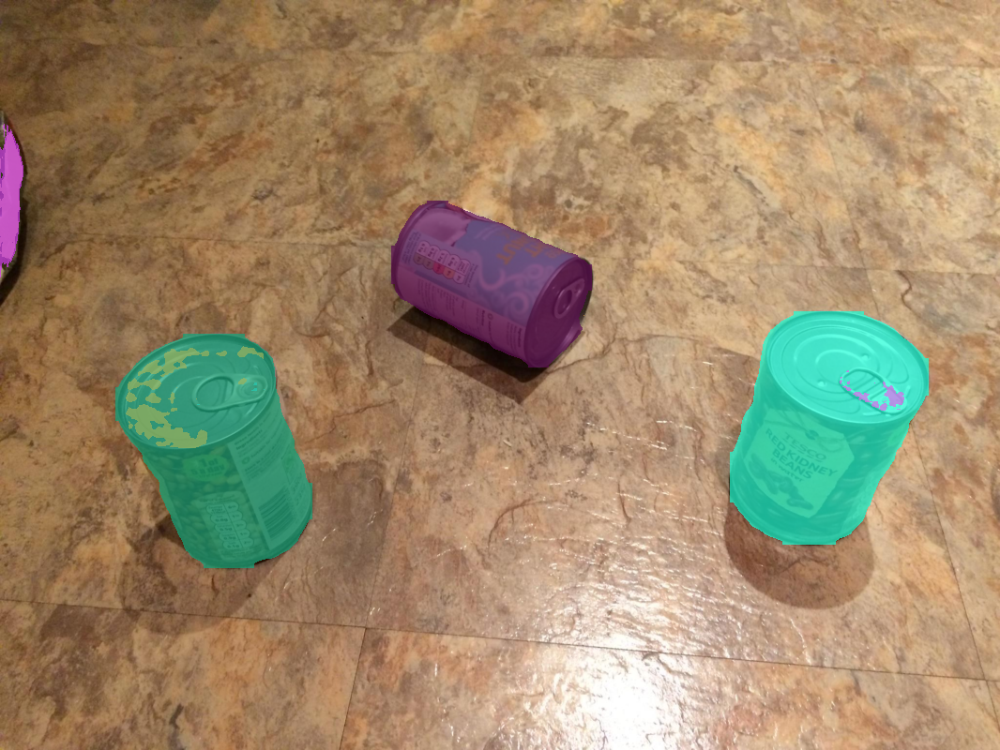

In [60]:
Image.fromarray(img_with_mask)

0.6

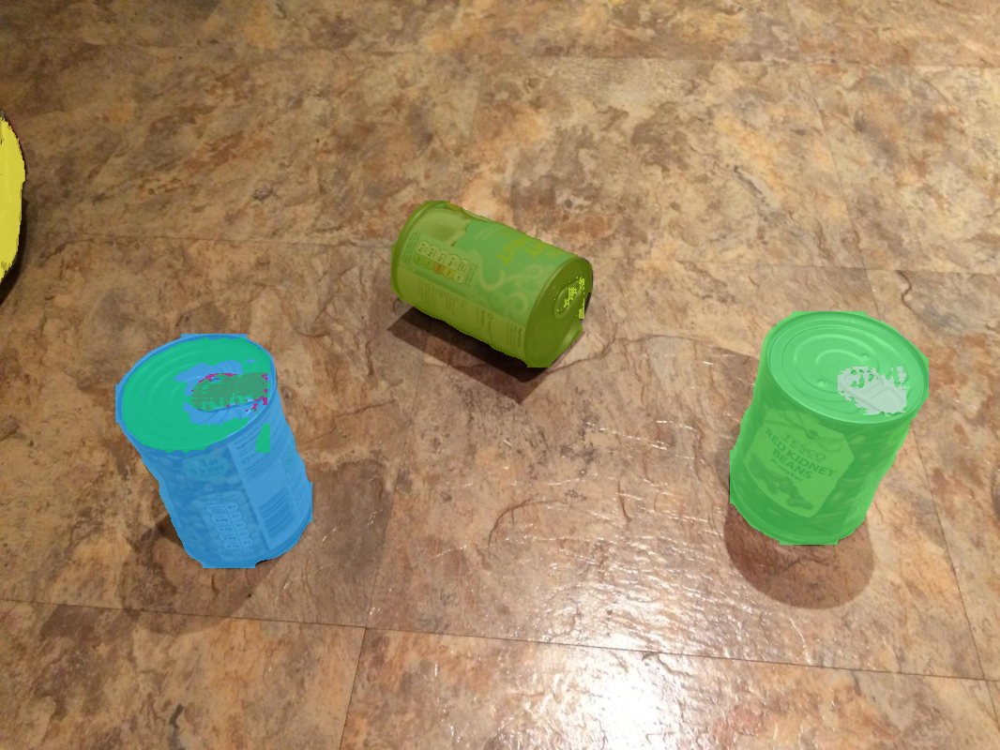

In [66]:
Image.fromarray(img_with_mask)

0.5

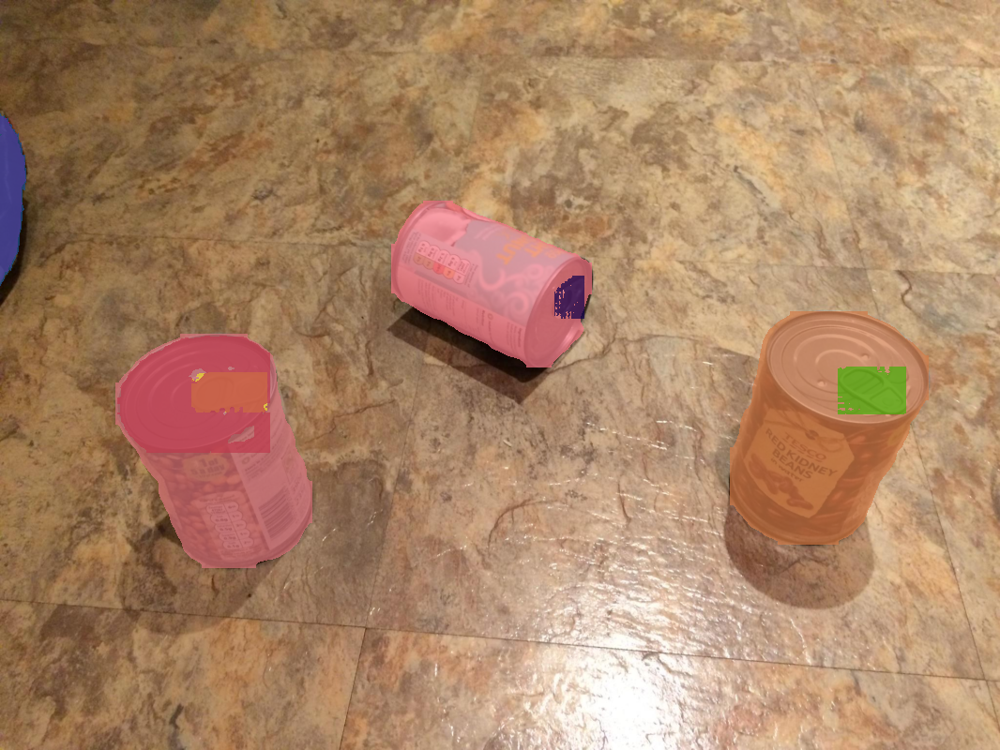

In [72]:
Image.fromarray(img_with_mask)

In [73]:
def predict(input_tensor, model, threshold=0.5):
  output = model(input_tensor)

  prob = output["pred_logits"].sigmoid()
  prob_view = prob.view(prob.shape[0], -1)
  keep = (prob_view > threshold).nonzero()
  keep_ind = keep // prob.shape[2]
  label = keep % prob.shape[2]

  return {
      "pred_labels": label[:, 1],
      "pred_boxes": torch.gather(output["pred_boxes"], 1, keep_ind[:, 1].unsqueeze(-1).repeat(1, 1, 4)),
      "unnormal_boxes": torch.gather(output["unnormal_boxes"], 1, keep_ind[:, 1].unsqueeze(-1).repeat(1, 1, 4))
  }

In [ ]:
def predict_one(input_tensor, model, threshold=0.5):
  output = model(input_tensor)

  output = output[0]

  prob = output["pred_logits"].sigmoid().unsqueeze(0)
  prob_view = prob.view(prob.shape[0], -1)
  keep = (prob_view > threshold).nonzero()
  keep_ind = keep // prob.shape[2]
  label = keep % prob.shape[2]

  return {
      "pred_labels": label[:, 1],
      "pred_boxes": torch.gather(output["pred_boxes"].unsqueeze(0), 1, keep_ind[:, 1].unsqueeze(-1).repeat(1, 1, 4))[0],
      "unnormal_boxes": torch.gather(output["unnormal_boxes"].unsqueeze(0), 1, keep_ind[:, 1].unsqueeze(-1).repeat(1, 1, 4))[0]
  }

In [ ]:
def draw_boxes(boxes, labels, classes, image):
    for i, box in enumerate(boxes):
        # color = COLORS[labels[i]]
        cv2.rectangle(
            image,
            (int(box[0]), int(box[1])),
            (int(box[2]), int(box[3])),
            255, 2
        )
        # cv2.putText(image, classes[i], (int(box[0]), int(box[1] - 5)), cv2.FONT_HERSHEY_SIMPLEX, 0.8, color, 2, lineType=cv2.LINE_AA)
    return image

In [ ]:
class MFDETRScoreTarget:
  def __init__(self, targets, iou_th=0.5):
    self.labels = targets["pred_labels"]
    self.bounding_boxes = targets["unnormal_boxes"]
    self.iou_th = iou_th

  def __call__(self, model_output):
    output = torch.Tensor([0])

    if torch.cuda.is_available():
      output = output.cuda()

    if len(model_output["unnormal_boxes"]) == 0:
      return output

    for box, label in zip(self.bounding_boxes, self.labels):
      box = torch.Tensor(box[None, :])

      if torch.cuda.is_available():
        box = box.cuda()

      ious = generalized_box_iou(box, model_output["unnormal_boxes"])
      index = ious.argmax()

      if ious[0, index] > self.iou_th and torch.argmax(model_output["pred_logits"][index]) == label:
        score = ious[0, index] + model_output["pred_logits"][index, label]
        output = output + score

      return output

In [ ]:
def MFDETR_reshape(x):
  return x[0][-1].tensors

In [ ]:
def swin_reshape(x, height=25, width=25):
  result = x.reshape(x.size(0), height, width, x.size(2))

  result = result.transpose(2, 3).transpose(1, 2)
  return result

In [ ]:
def Ablation_reshape(x):
  target_size = x[0]["3"].tensors.size()[-2:]
  activations = []
  for key, value in x[0].items():
    activations.append(torch.nn.functional.interpolate(torch.abs(value.tensors), target_size, mode='bilinear'))
  activations = torch.cat(activations, axis=1)
  return activations

In [ ]:
class AblationLayerMFDETR(AblationLayer):
  def __init__(self):
      super(AblationLayerMFDETR, self).__init__()

  def get_layer_index(self, i):
    # TODO: Make this dynamic
    thresholds = [191, 575]
    return sum(i > t for t in thresholds)

  def set_next_batch(self, input_batch_index, activations, num_channels_to_ablate):
      self.activations = []
      self.masks = []
      self.sizes = []

      self.fl = activations[1]

      for key, value in activations[0].items():
        layer_activation = value.tensors[input_batch_index, :, :, :].clone().unsqueeze(0)
        self.activations.append(layer_activation.repeat(num_channels_to_ablate, 1, 1, 1))
        self.masks.append(value.mask[input_batch_index, :, :].clone().unsqueeze(0).repeat(num_channels_to_ablate, 1, 1))
        self.sizes.append(value.sizes)

  def __call__(self, x):
    channels = [192, 384]

    result = self.activations
    num_channels_to_ablate = result[0].size(0)

    for i in range(num_channels_to_ablate):
      num_layer = self.get_layer_index(i)
      to_remove = sum(channels[:num_layer])
      index_in_layers = i - to_remove
      result[num_layer][i, index_in_layers, :, :] = -1000

    return {str(i + 1): mutils.NestedTensor(result[i], self.masks[i], self.sizes[i]) for i in range(len(result))}, self.fl

In [ ]:
class AblationCAMOutputWrapper(torch.nn.Module):
  def __init__(self, model):
    super(AblationCAMOutputWrapper, self).__init__()
    self.model = model

  def forward(self, x):
    input_tensor = mutils.NestedTensor(x, torch.zeros((x.shape[0], x.shape[2], x.shape[3]), dtype=torch.bool), torch.tensor([[x.shape[2], x.shape[3]]]))
    input_tensor = input_tensor.to("cuda")
    out = self.model(input_tensor)
    # out = self.model(x)

    ret = []
    for i in range(out["pred_logits"].shape[0]):
      ret.append({k: v[i] for k, v in out.items()})

    input_tensor.tensors = input_tensor.tensors.cpu()
    input_tensor.mask = input_tensor.mask.cpu()
    input_tensor.sizes = input_tensor.sizes.cpu()
    del input_tensor
    return ret

wrapped_mfdetr = AblationCAMOutputWrapper(mfdetr)

In [ ]:
output = predict_one(input_tensor, wrapped_mfdetr, 0.3)

NameError: name 'predict_one' is not defined

In [ ]:
indices = torch.nonzero(output["pred_labels"] == 8).cpu().numpy()
indices = [i[0] for i in indices]

In [ ]:
indices = [1]

In [ ]:
output["pred_labels"] = output["pred_labels"][indices]
output["pred_boxes"]  = output["pred_boxes"][indices]
output["unnormal_boxes"]  = output["unnormal_boxes"][indices]

In [ ]:
target_layers = [mfdetr.detr.backbone[0]]
targets = [MFDETRScoreTarget(output)]

cam_ablation = AblationCAM(wrapped_mfdetr,
               target_layers,
               reshape_transform=Ablation_reshape,
               ablation_layer=AblationLayerMFDETR(),
               batch_size=4)

In [ ]:
target_layers = [mfdetr.detr.backbone[0].body.layers[-1].blocks[-1].norm2]
targets = [MFDETRScoreTarget(output)]

cam_ablation = AblationCAM(wrapped_mfdetr,
               target_layers,
               reshape_transform=swin_reshape,
               ablation_layer=AblationLayerVit(),
               batch_size=4)

In [ ]:
grayscale_cam = cam_ablation(batch_input[0], targets=targets)

100%|██████████| 192/192 [04:03<00:00,  1.27s/it]


In [ ]:
grayscale_cam = cam_ablation(input_tensor, targets=targets)

100%|██████████| 192/192 [04:28<00:00,  1.40s/it]


In [ ]:
target_layers = [mfdetr.detr.backbone]
targets = [MFDETRScoreTarget(output)]

cam_eigen = EigenCAM(
    mfdetr,
    target_layers,
    reshape_transform=MFDETR_reshape
)

In [ ]:
target_layers = [mfdetr.detr.backbone[0].body.layers[-1].blocks[-1].norm2]
targets = [MFDETRScoreTarget(output)]

cam_eigen = EigenCAM(
    wrapped_mfdetr,
    target_layers,
    reshape_transform=swin_reshape
)

In [ ]:
grayscale_cam = cam_eigen(batch_input[0], targets=targets)

NameError: name 'batch_input' is not defined

In [ ]:
grayscale_cam = cam_eigen(input_tensor, targets=targets)

In [ ]:
target_layers = [mfdetr.detr.backbone[0].body.layers[-1].blocks[-1].norm2]
targets = [MFDETRScoreTarget(output)]

cam_grad = GradCAM(
    wrapped_mfdetr,
    target_layers,
    reshape_transform=swin_reshape
)

In [ ]:
grayscale_cam = cam_grad(input_tensor, targets=targets)

In [ ]:
target_layers = [mfdetr.detr.backbone[0].body.layers[-1].blocks[-1].norm2]
targets = [MFDETRScoreTarget(output)]

cam_grad_plusplus = GradCAMPlusPlus(
    wrapped_mfdetr,
    target_layers,
    reshape_transform=swin_reshape
)

In [ ]:
grayscale_cam = cam_grad_plusplus(input_tensor, targets=targets)

/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:460: UserWarning: torch.utils.checkpoint: please pass in use_reentrant=True or use_reentrant=False explicitly. The default value of use_reentrant will be updated to be False in the future. To maintain current behavior, pass use_reentrant=True. It is recommended that you use use_reentrant=False. Refer to docs for more details on the differences between the two variants.
  warnings.warn(


In [ ]:
target_layers = [mfdetr.detr.backbone[0].body.layers[-1].blocks[-1].norm2]
targets = [MFDETRScoreTarget(output)]

cam_score = ScoreCAM(wrapped_mfdetr,
               target_layers,
               reshape_transform=swin_reshape)

cam_score.batch_size = 1

In [ ]:
grayscale_cam = cam_score(input_tensor, targets=targets)

100%|██████████| 768/768 [04:16<00:00,  2.99it/s]


In [ ]:
resize_img = img.resize((800, 800))

In [ ]:
image_float = np.float32(np.array(resize_img)) / 255

In [ ]:
cam_image = show_cam_on_image(image_float, grayscale_cam[0, :], use_rgb=True)

In [ ]:
image_with_bounding_boxes = draw_boxes(output["unnormal_boxes"], None, None, cam_image)

Ablation cam with target backbone

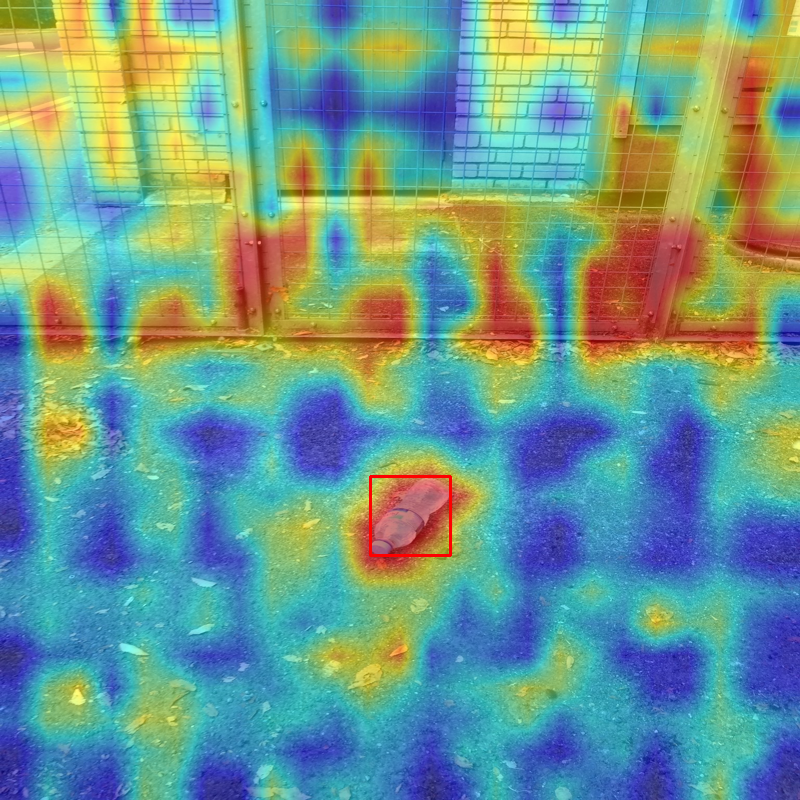

In [ ]:
Image.fromarray(image_with_bounding_boxes)

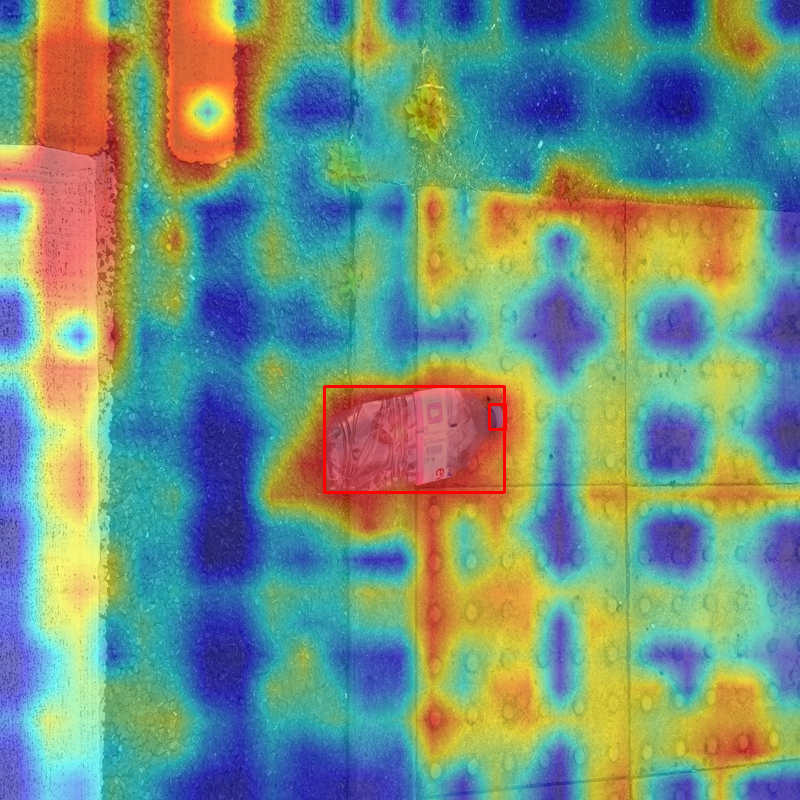

In [ ]:
Image.fromarray(image_with_bounding_boxes)

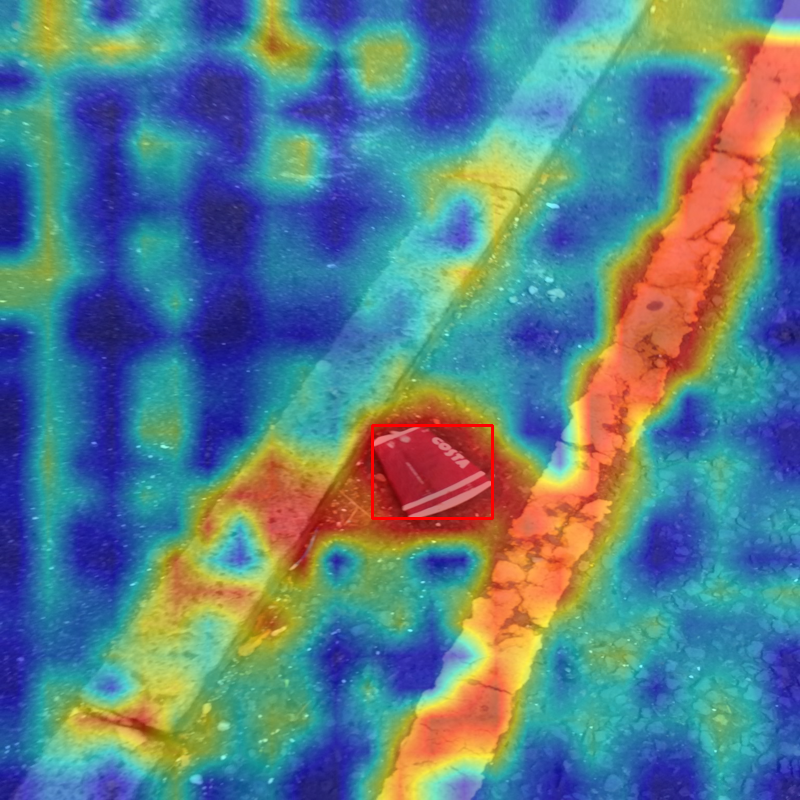

In [ ]:
Image.fromarray(image_with_bounding_boxes)

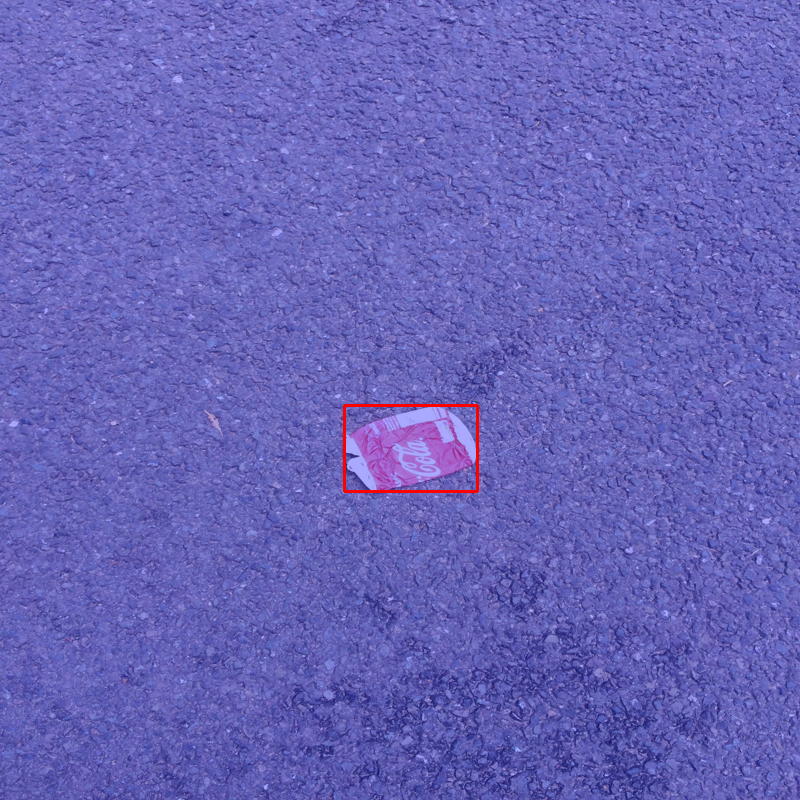

In [ ]:
Image.fromarray(image_with_bounding_boxes)

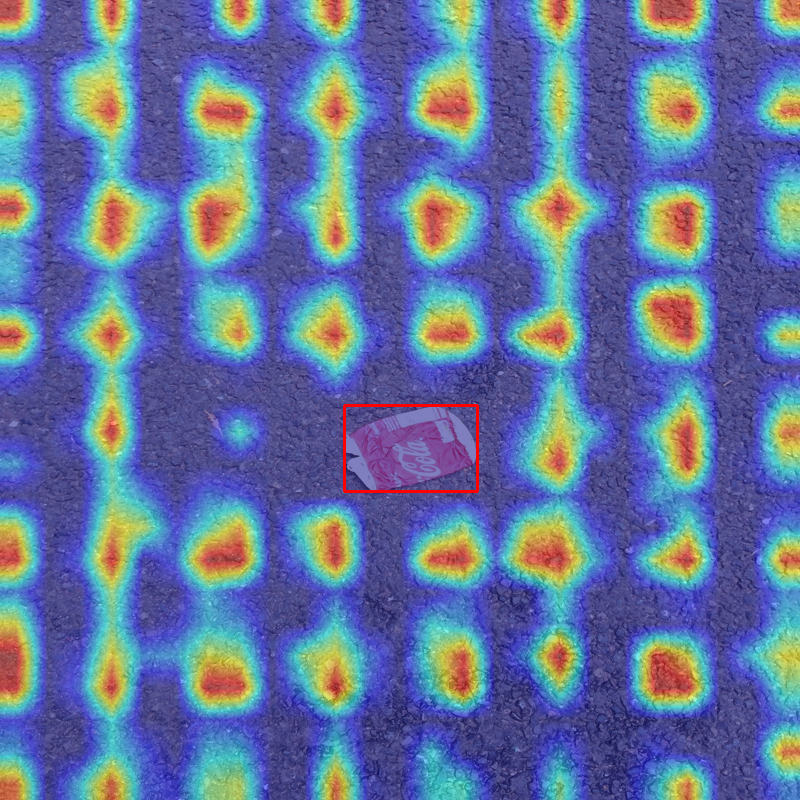

In [ ]:
Image.fromarray(image_with_bounding_boxes)

Eigen CAM

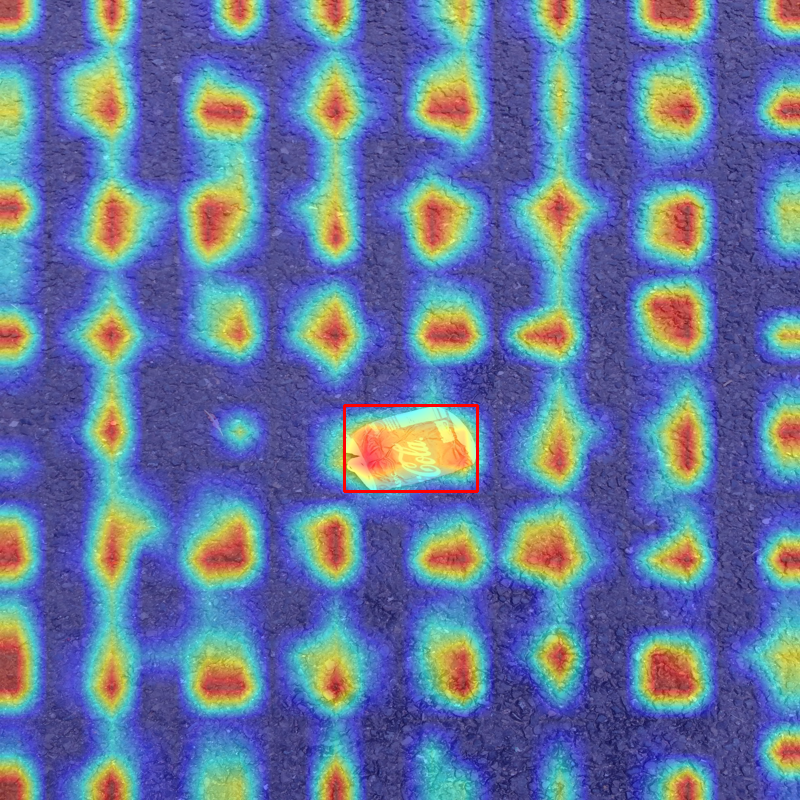

In [ ]:
Image.fromarray(image_with_bounding_boxes)

Ablation CAM

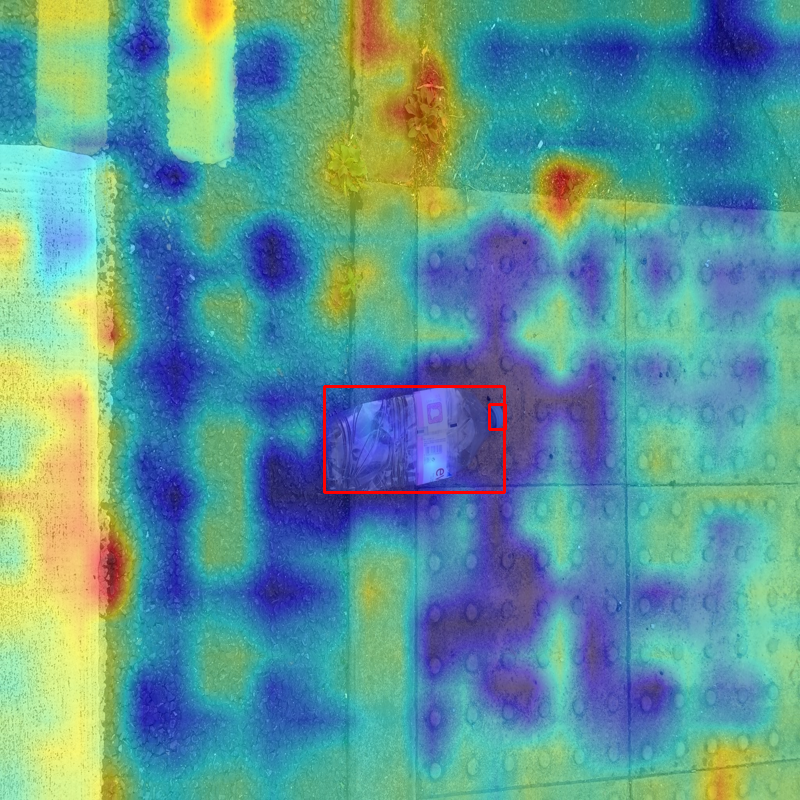

In [ ]:
Image.fromarray(image_with_bounding_boxes)

Eigen CAM

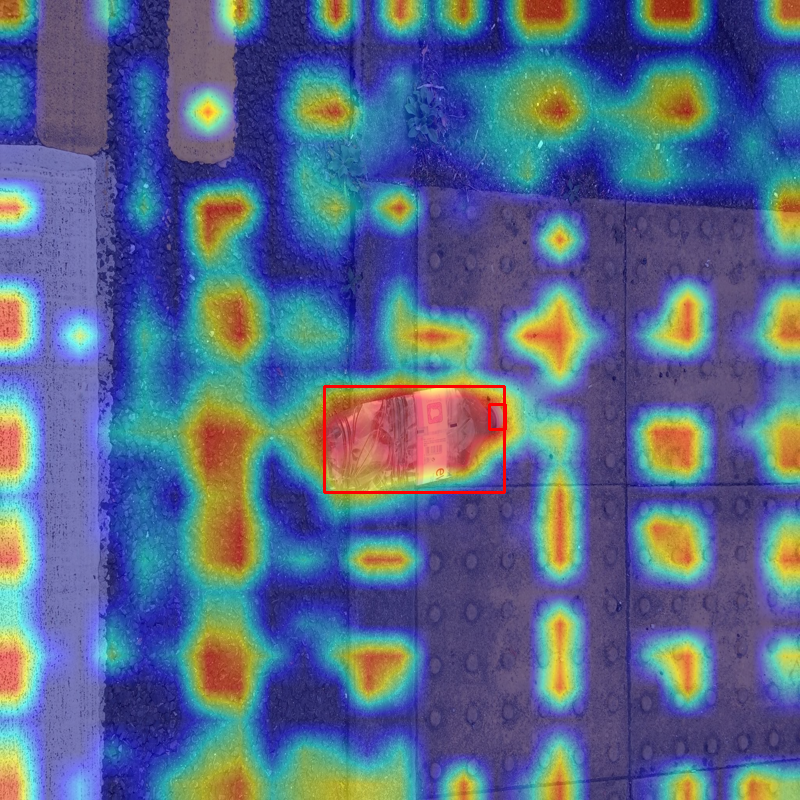

In [ ]:
Image.fromarray(image_with_bounding_boxes)

Score CAM

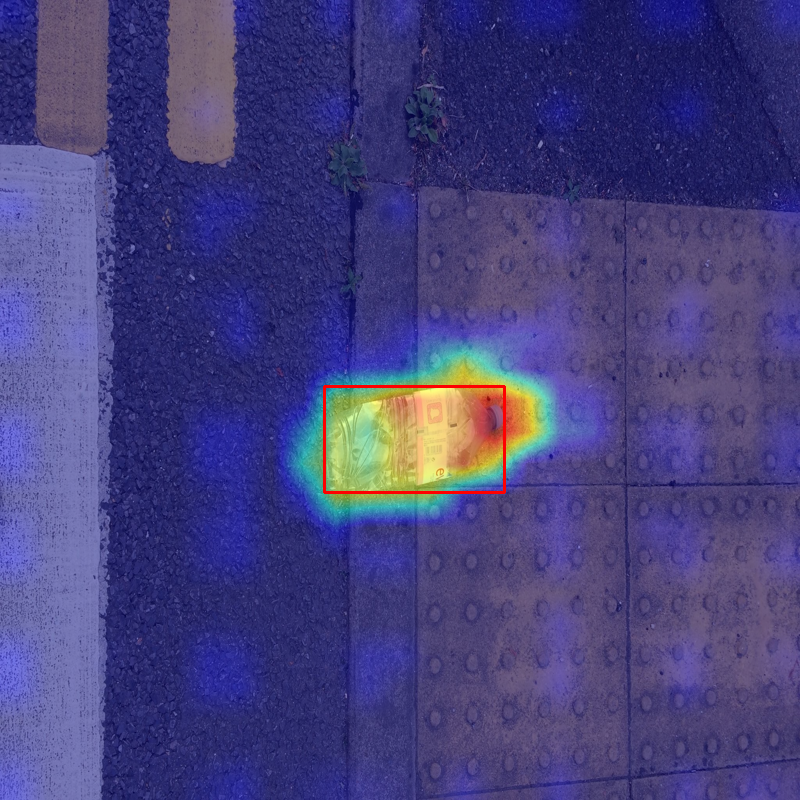

In [ ]:
Image.fromarray(image_with_bounding_boxes)

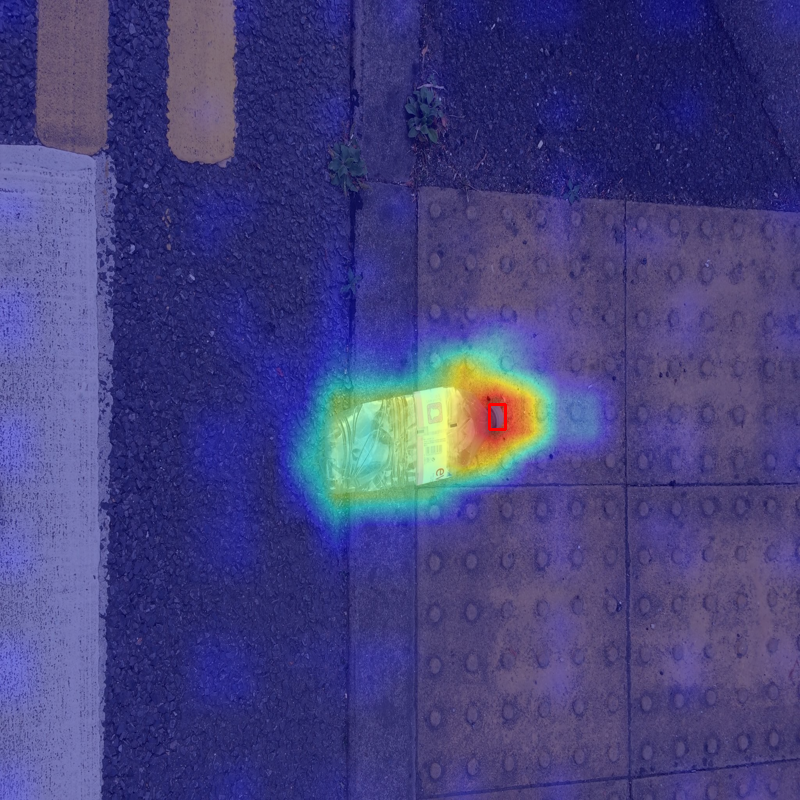

In [ ]:
Image.fromarray(image_with_bounding_boxes)

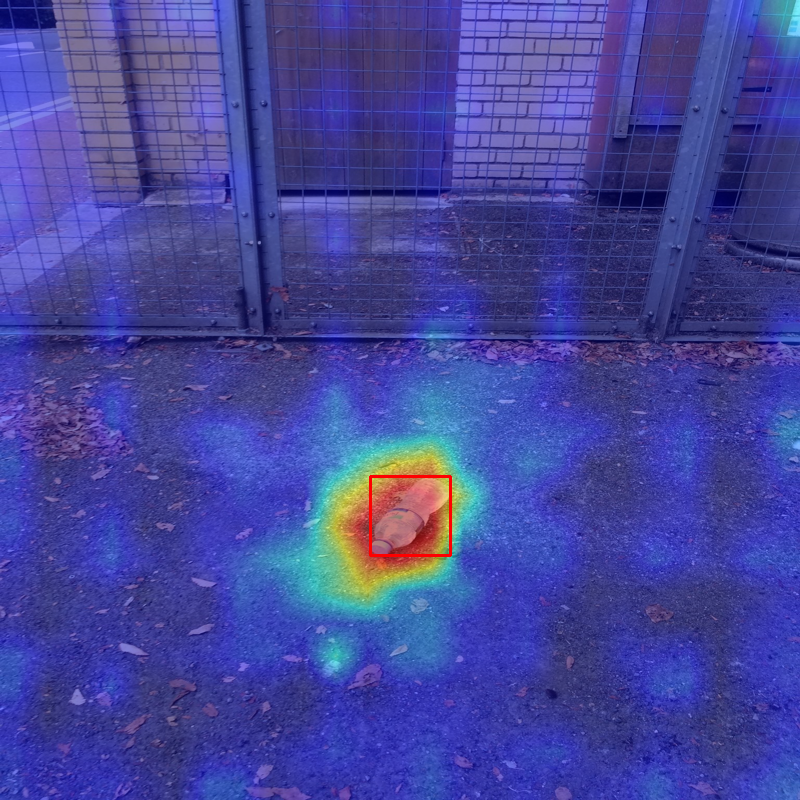

In [ ]:
Image.fromarray(image_with_bounding_boxes)

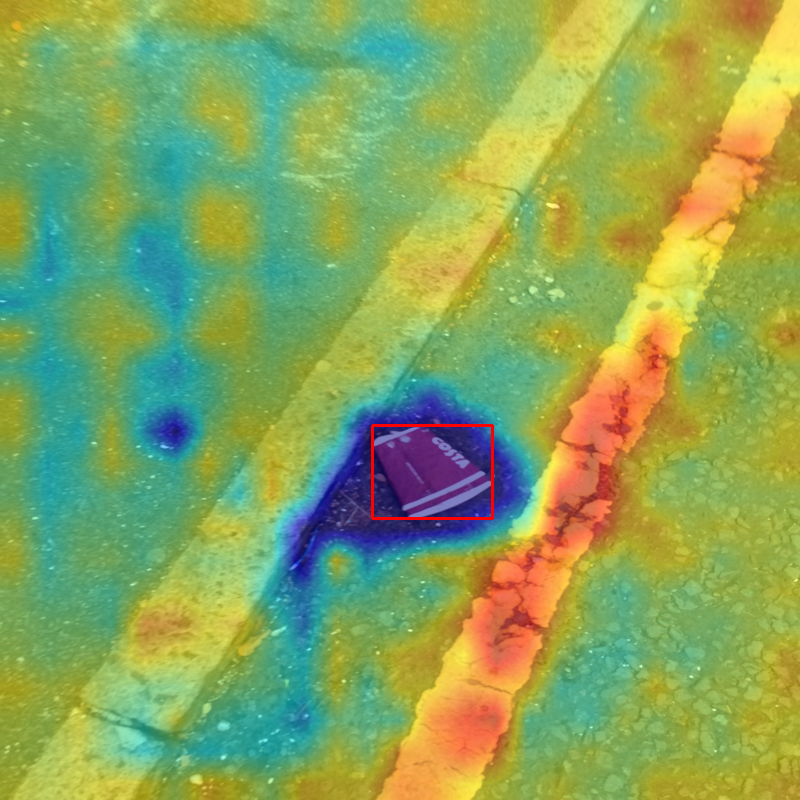

In [ ]:
Image.fromarray(image_with_bounding_boxes)

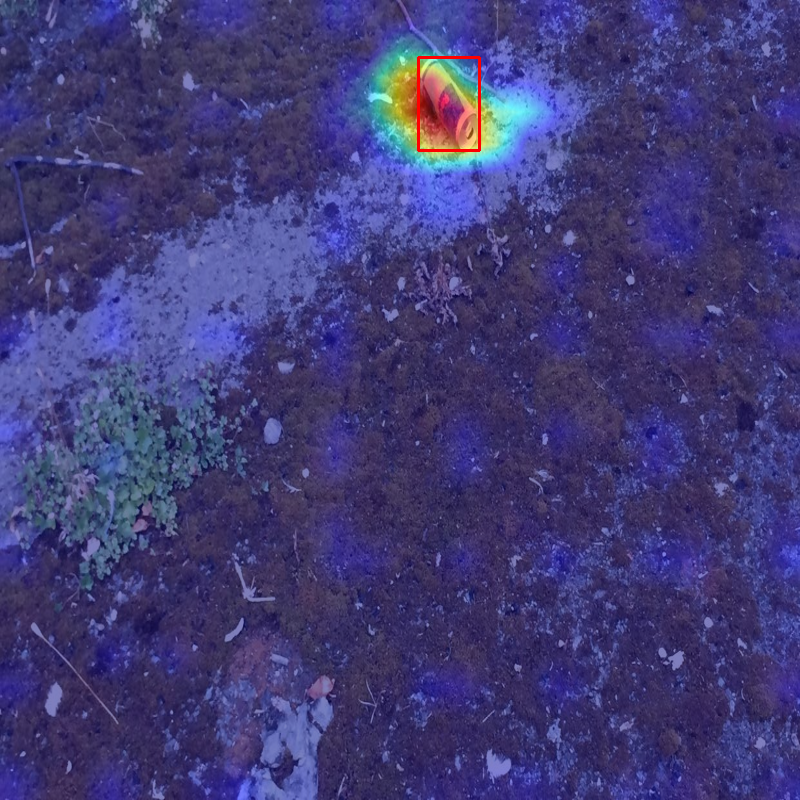

In [ ]:
Image.fromarray(image_with_bounding_boxes)

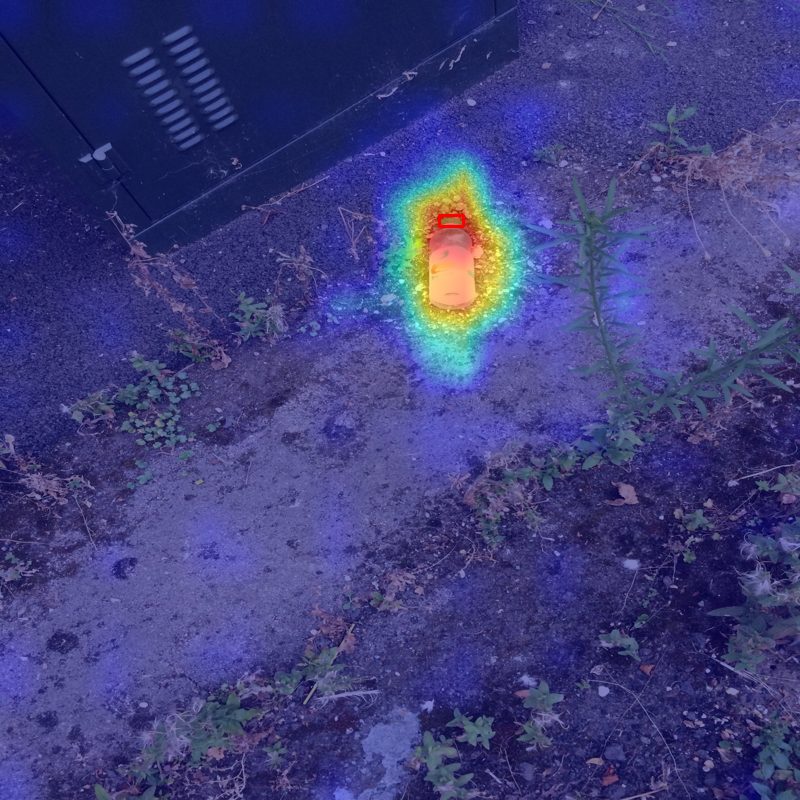

In [ ]:
Image.fromarray(image_with_bounding_boxes)

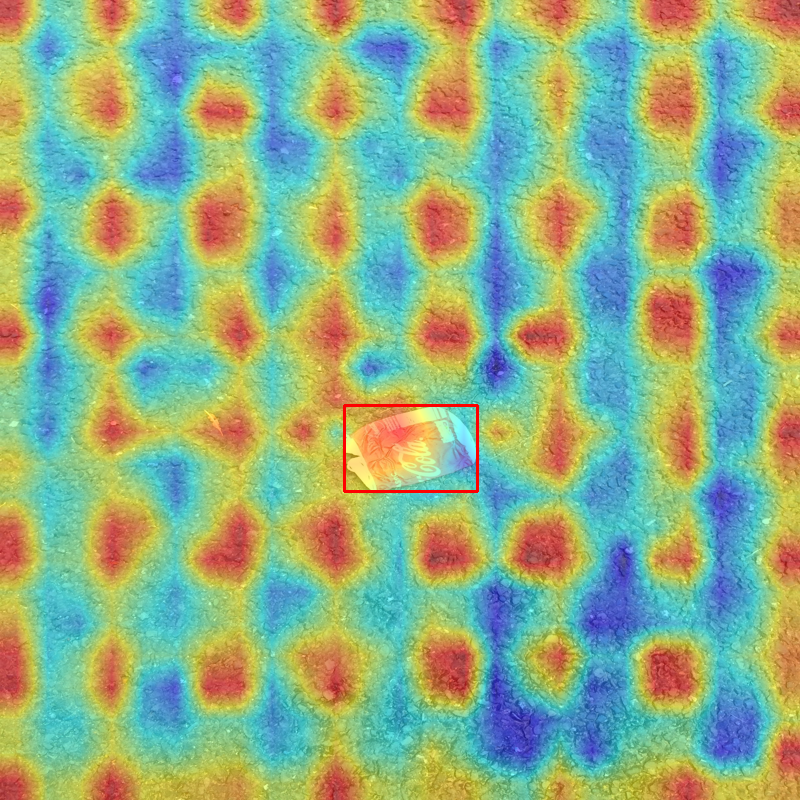

In [ ]:
Image.fromarray(image_with_bounding_boxes)

Class 7

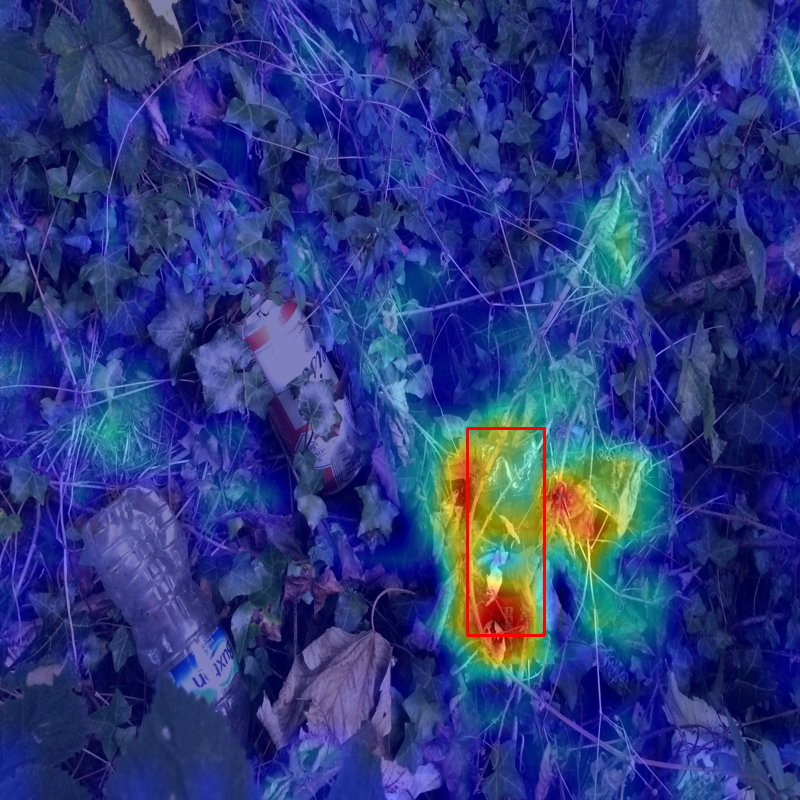

In [ ]:
Image.fromarray(image_with_bounding_boxes)

Class 2

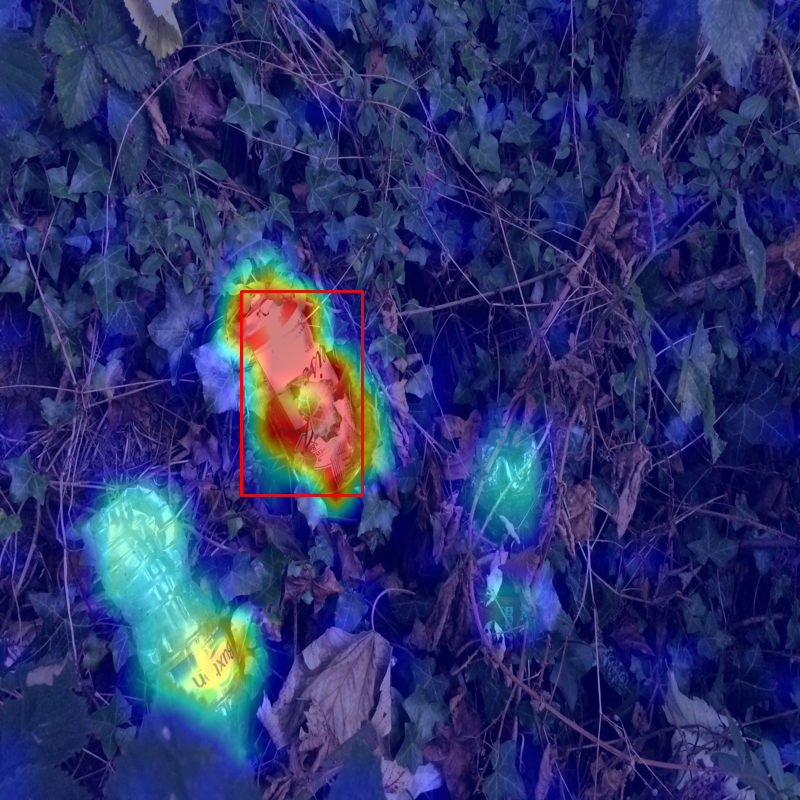

In [ ]:
Image.fromarray(image_with_bounding_boxes)

Class 0

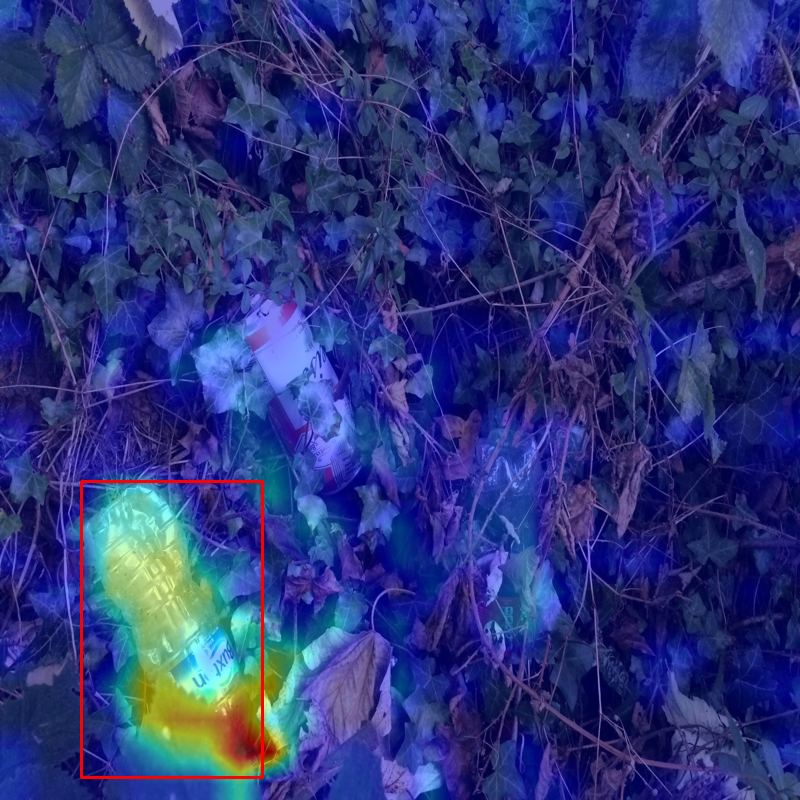

In [ ]:
Image.fromarray(image_with_bounding_boxes)

Class 2 - Multiple BB in target

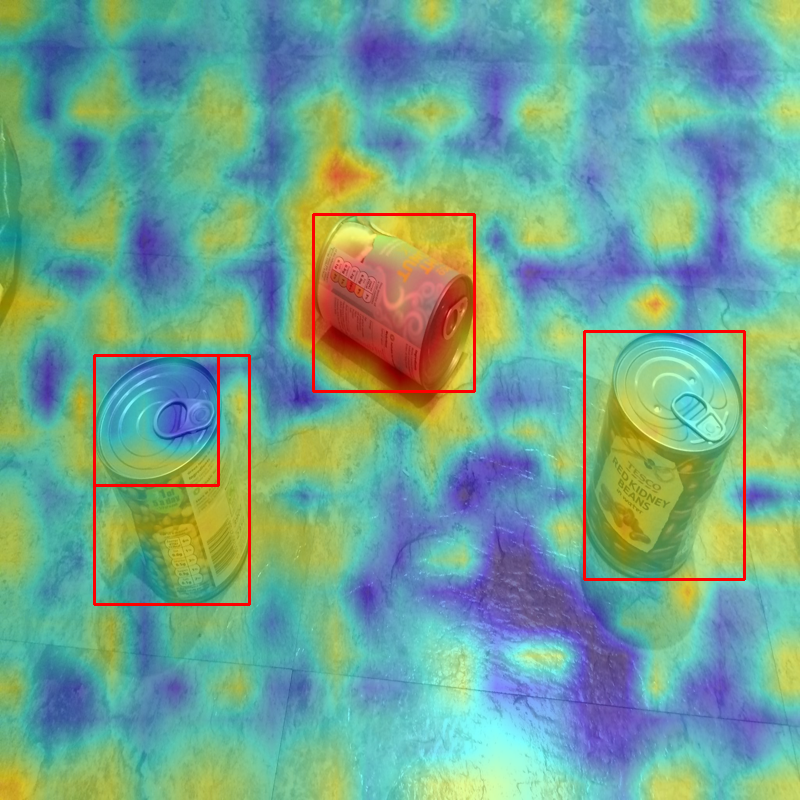

In [ ]:
Image.fromarray(image_with_bounding_boxes)

Class 2 - Only one BB in Target

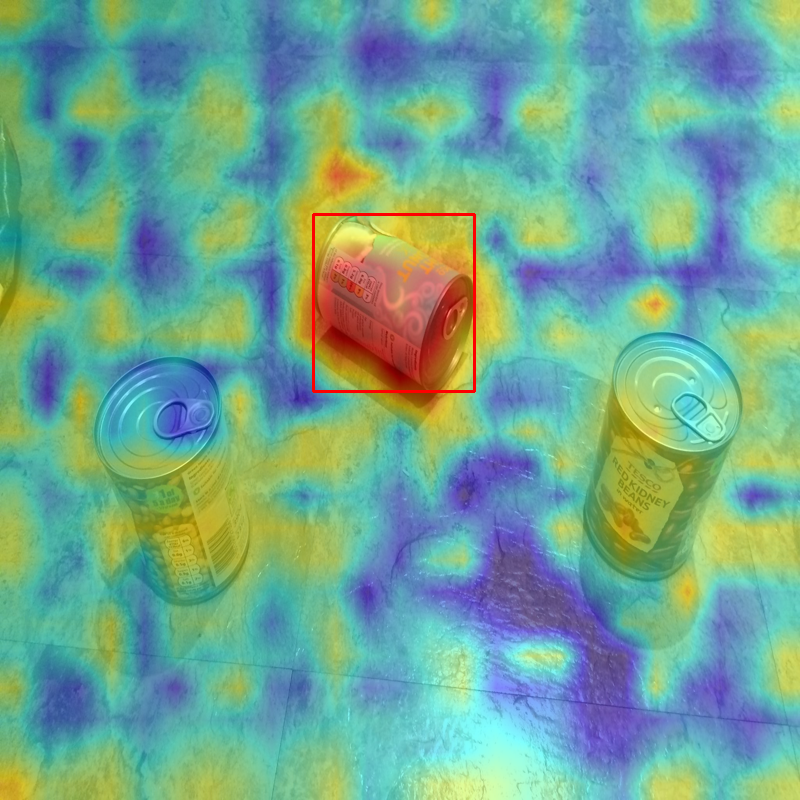

In [ ]:
Image.fromarray(image_with_bounding_boxes)

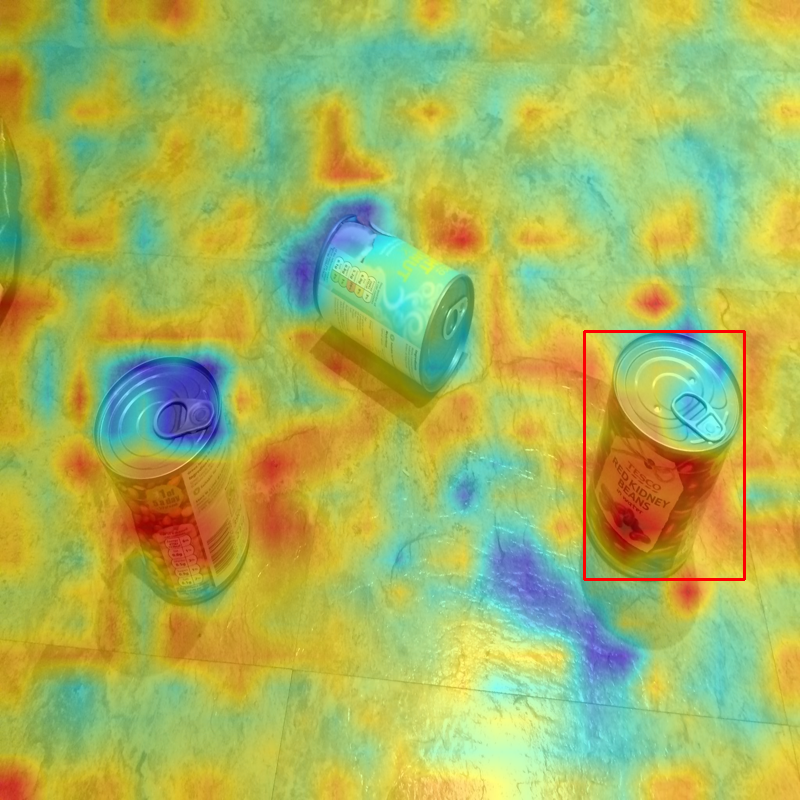

In [ ]:
Image.fromarray(image_with_bounding_boxes)

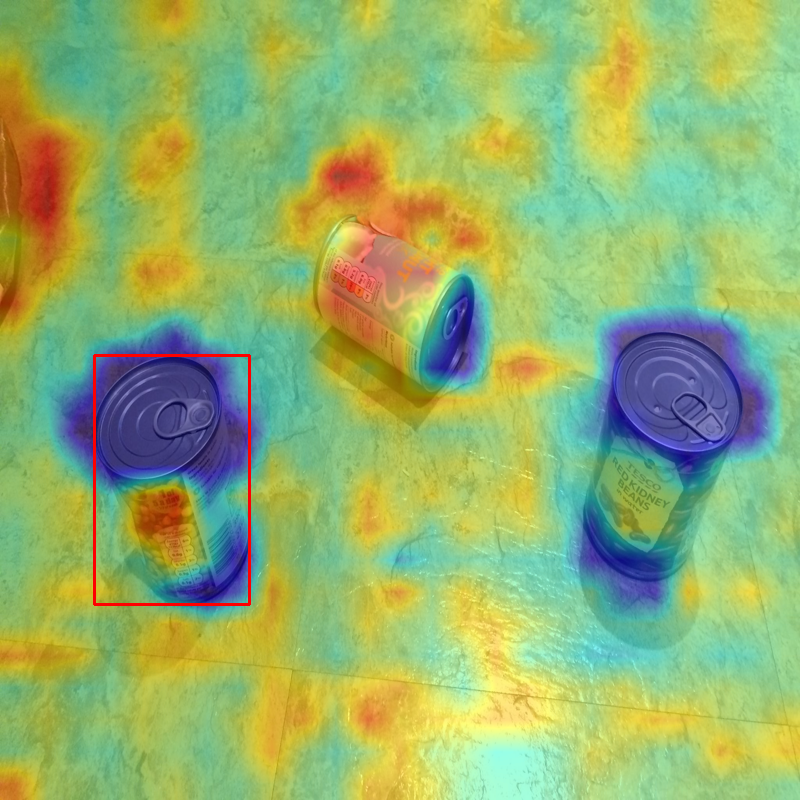

In [ ]:
Image.fromarray(image_with_bounding_boxes)

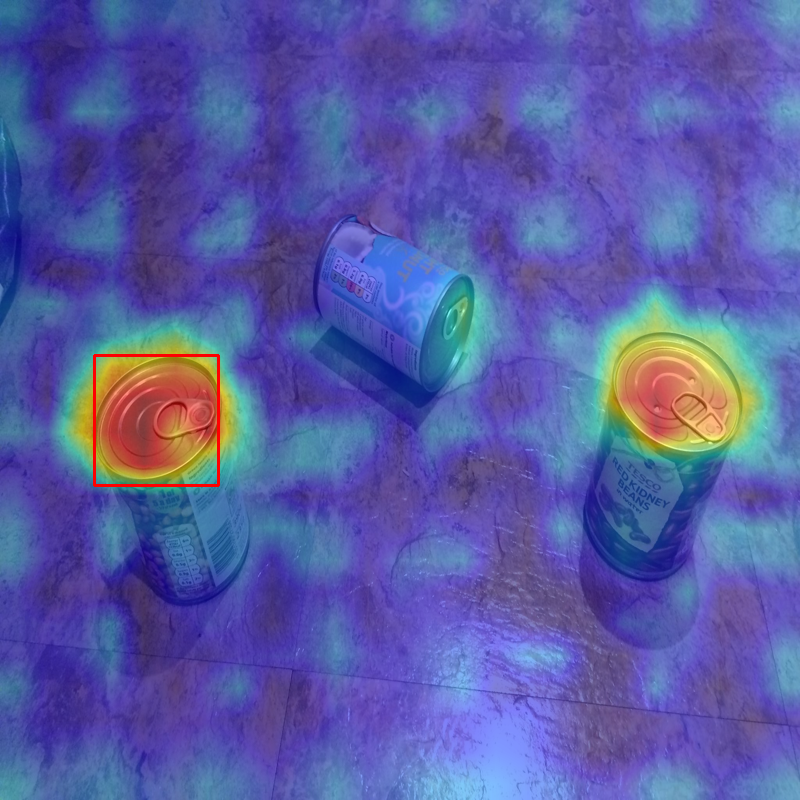

In [ ]:
Image.fromarray(image_with_bounding_boxes)

Class 8 - Multiple BB in target

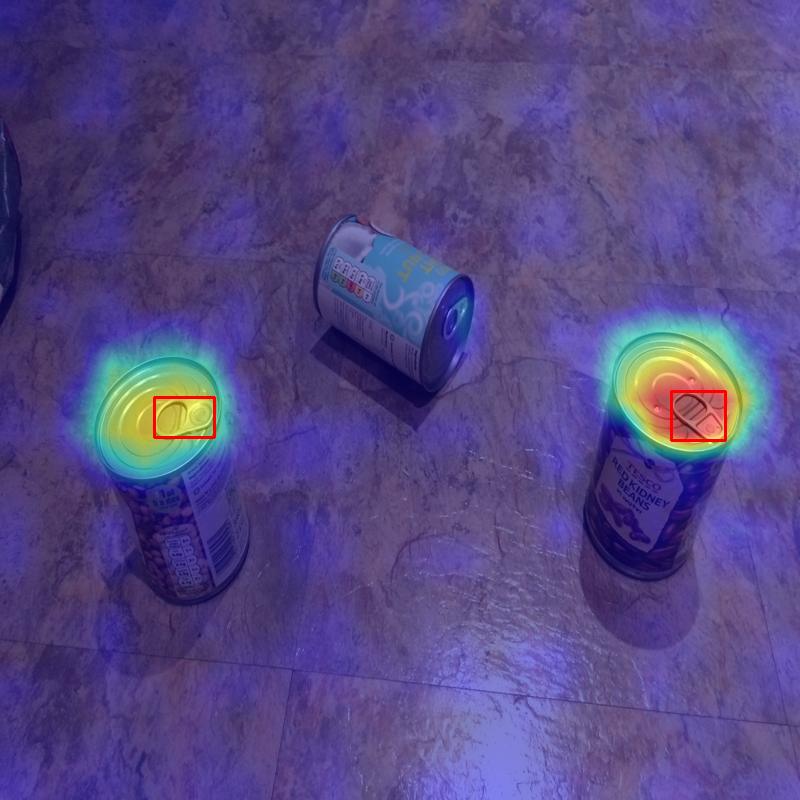

In [ ]:
Image.fromarray(image_with_bounding_boxes)

Class 8 - Single BB in target

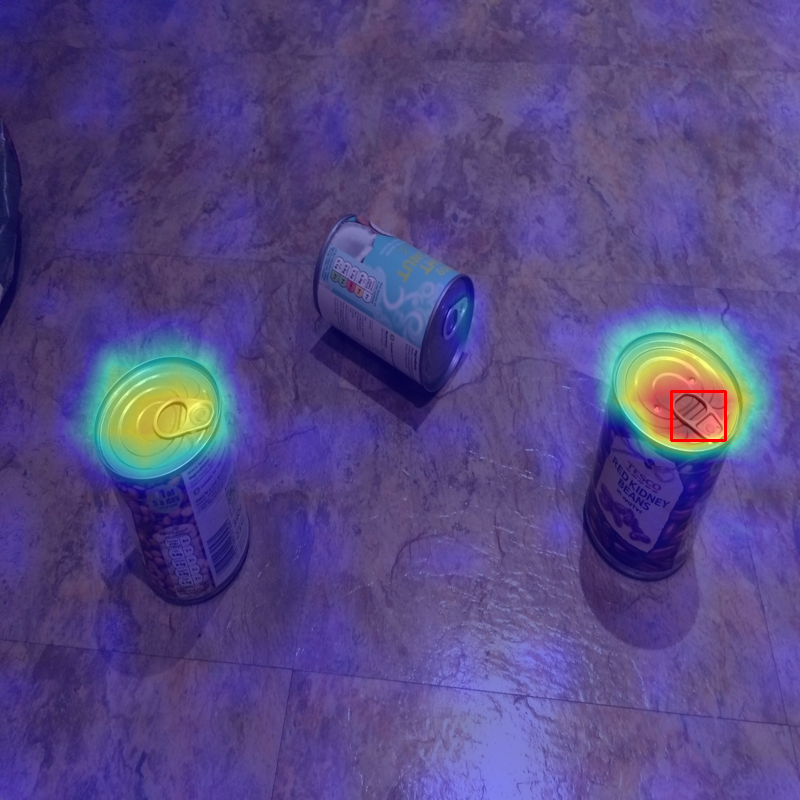

In [ ]:
Image.fromarray(image_with_bounding_boxes)

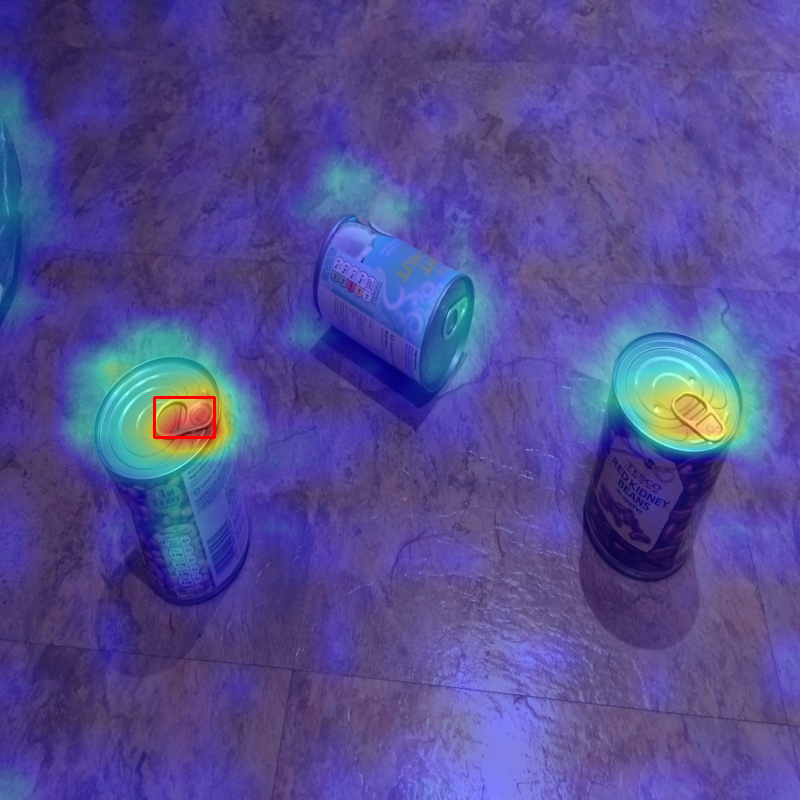

In [ ]:
Image.fromarray(image_with_bounding_boxes)

Grad CAM

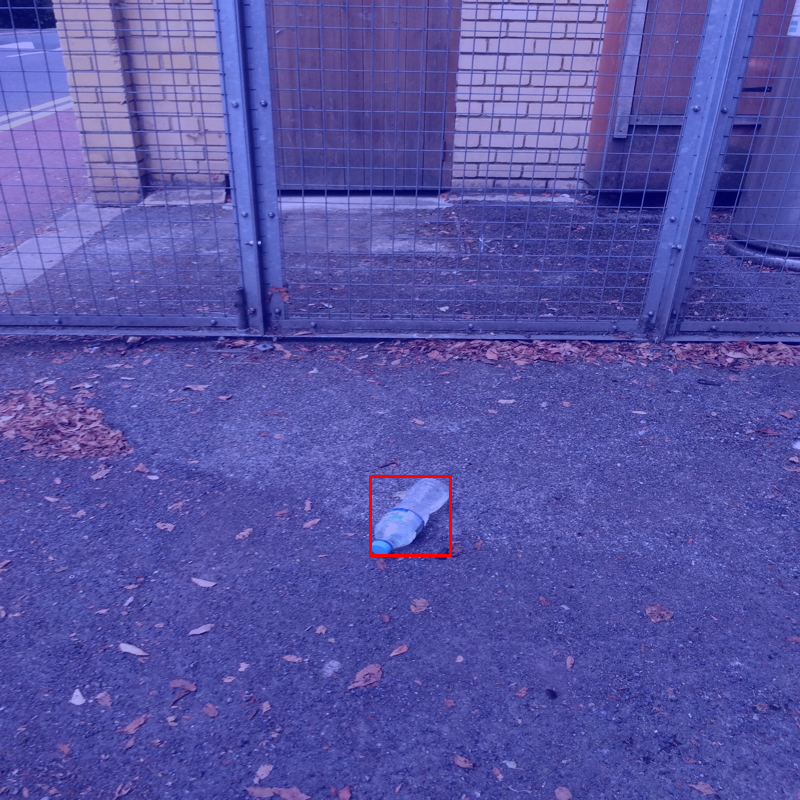

In [ ]:
Image.fromarray(image_with_bounding_boxes)

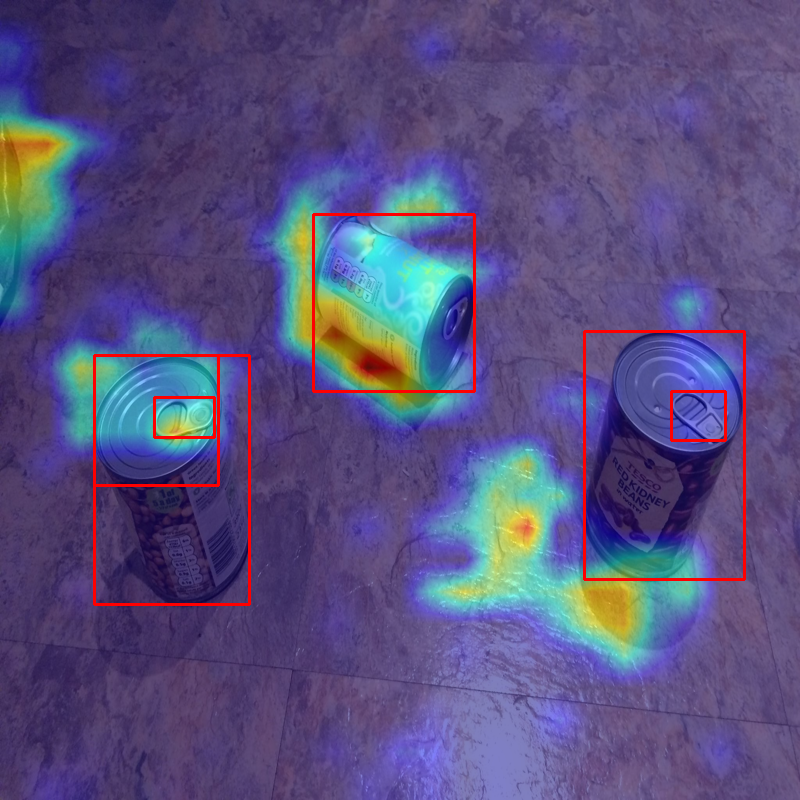

In [ ]:
Image.fromarray(image_with_bounding_boxes)

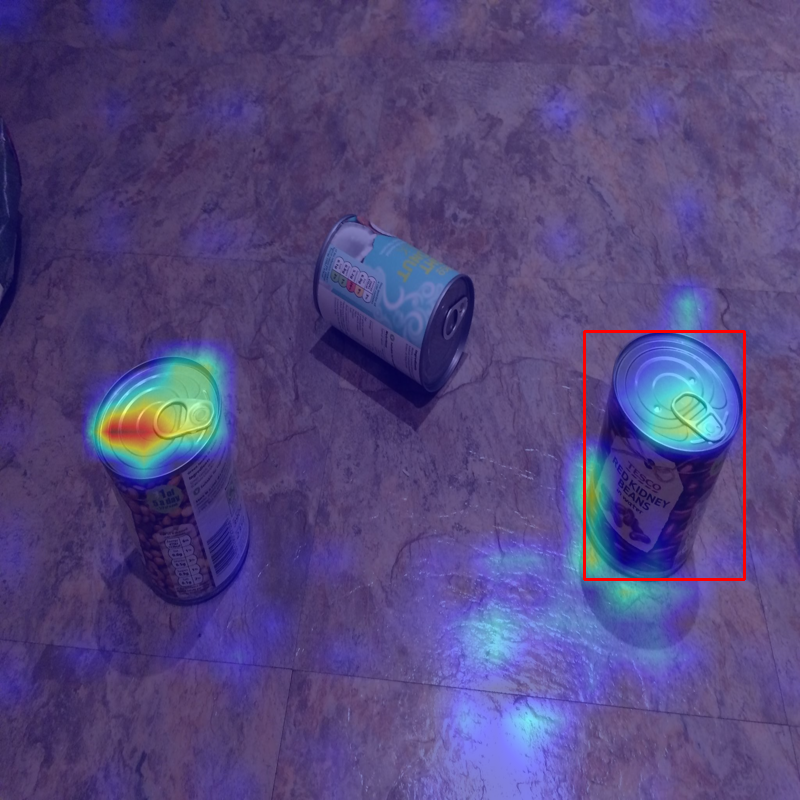

In [ ]:
Image.fromarray(image_with_bounding_boxes)

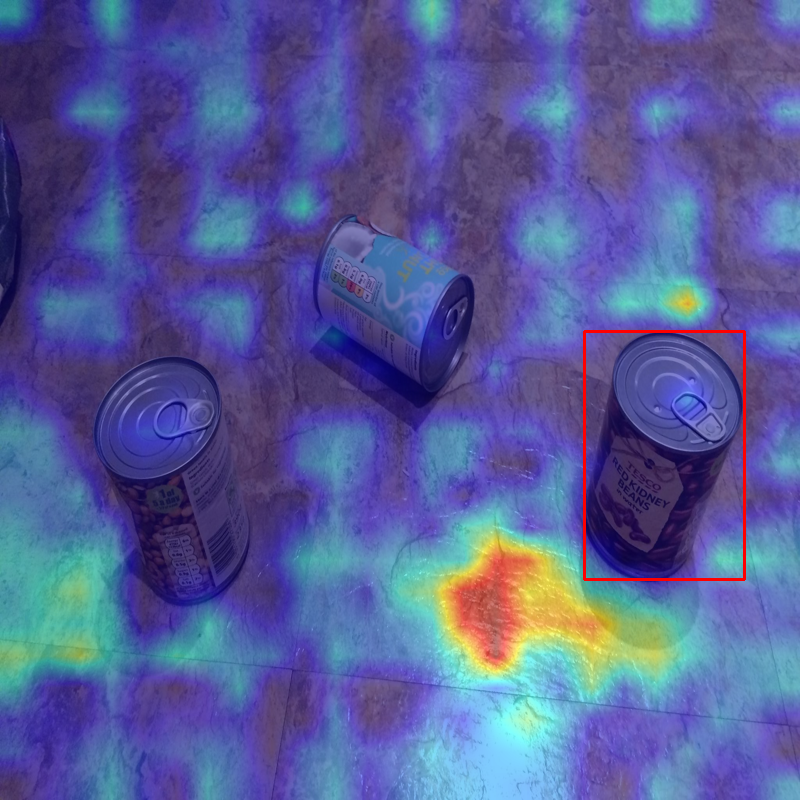

In [ ]:
Image.fromarray(image_with_bounding_boxes)